In [1]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets, models, transforms
from torch.utils.data import DataLoader
import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping
from pytorch_lightning.loggers import TensorBoardLogger
from unet_autoencoder import *
from clasificadorA import VGG16Lightning
from clasificadorB1 import *
from pytorch_lightning.loggers import WandbLogger
import wandb

# Clasificador B1 con autoencoder 70% y 30% con label

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type        | Params
-------------------------------------------
0 | encoder1   | UNetEncoder | 39.0 K
1 | encoder2   | UNetEncoder | 221 K 
2 | encoder3   | UNetEncoder | 886 K 
3 | encoder4   | UNetEncoder | 3.5 M 
4 | bottleneck | Sequential  | 14.2 M
5 | decoder1   | UNetDecoder | 9.2 M 
6 | decoder2   | UNetDecoder | 2.3 M 
7 | decoder3   | UNetDecoder | 574 K 
8 | decoder4   | UNetDecoder | 143 K 
9 | final_conv | Conv2d      | 195   
-------------------------------------------
31.0 M    Trainable params
0         Non-trainable params
31.0 M    Total params
124.175   Total estimated model params size (MB)


Sanity Checking DataLoader 0:   0%|          | 0/2 [00:00<?, ?it/s]

c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=15` in the `DataLoader` to improve performance.


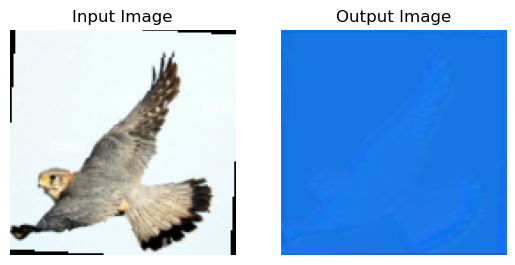

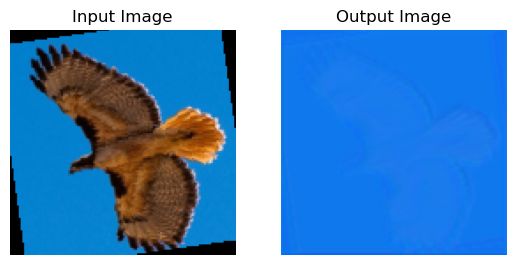

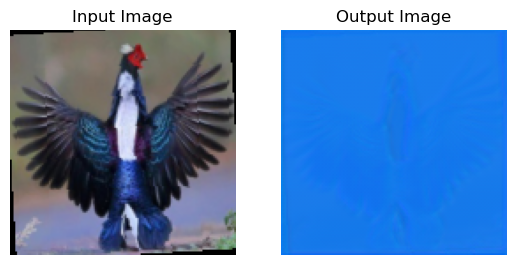

c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=15` in the `DataLoader` to improve performance.


Epoch 0:   0%|          | 0/116 [00:00<?, ?it/s] 

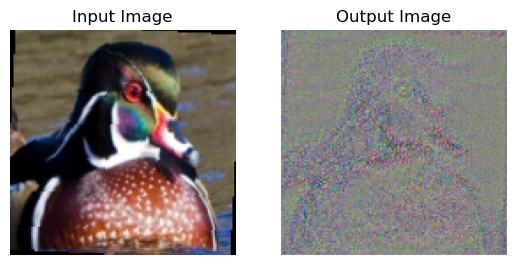

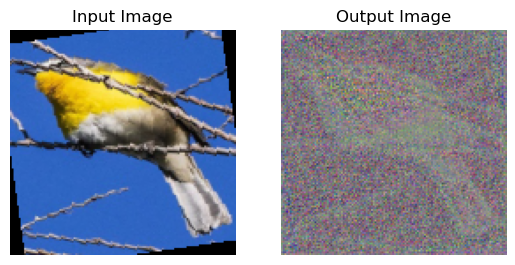

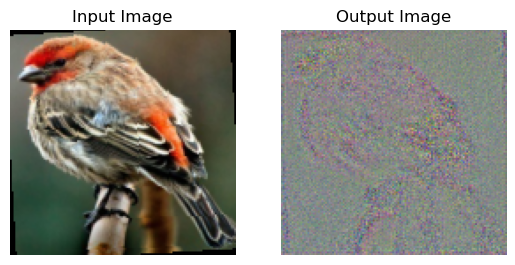

Epoch 0: 100%|██████████| 116/116 [00:18<00:00,  6.15it/s, v_num=3]

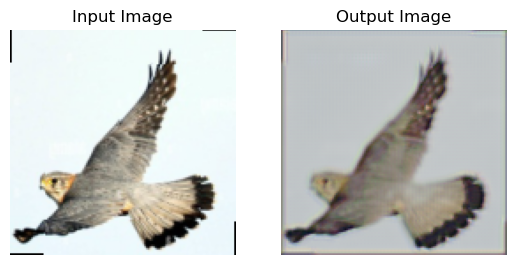

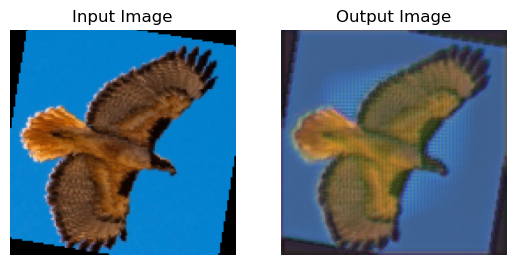

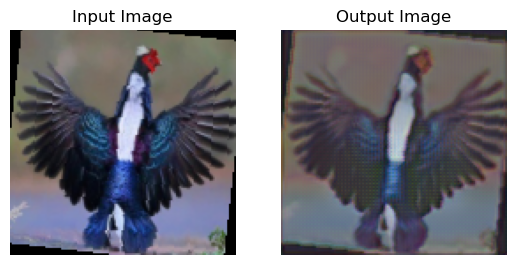

Epoch 1:   0%|          | 0/116 [00:00<?, ?it/s, v_num=3]          

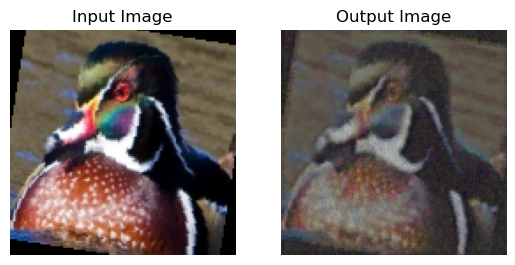

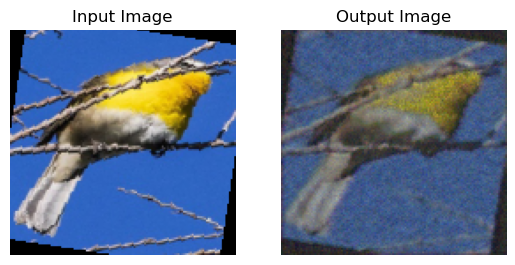

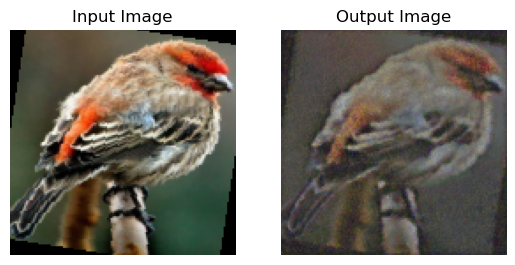

Epoch 1: 100%|██████████| 116/116 [00:18<00:00,  6.20it/s, v_num=3]

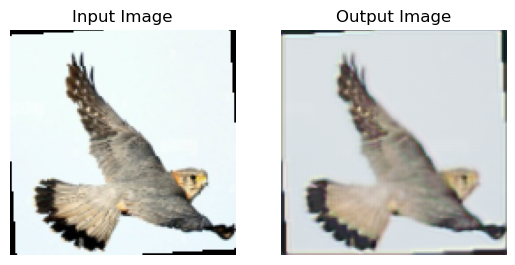

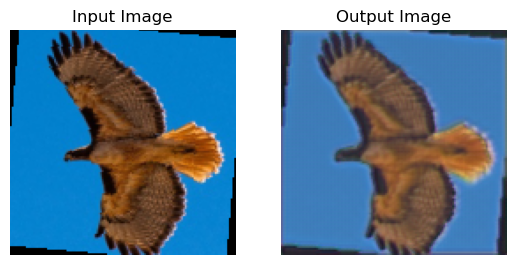

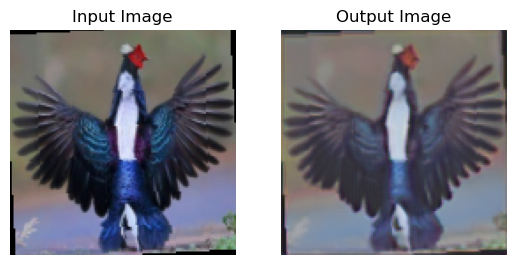

Epoch 2:   0%|          | 0/116 [00:00<?, ?it/s, v_num=3]          

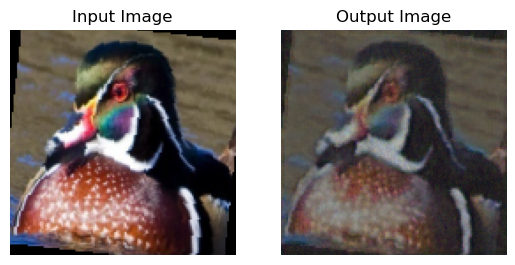

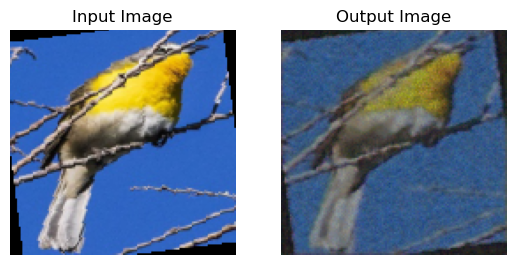

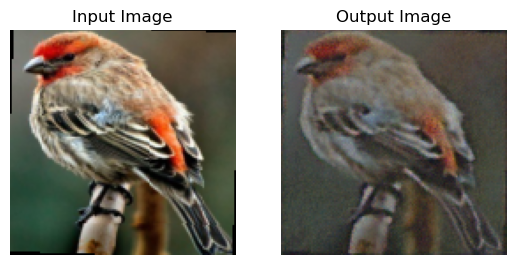

Epoch 2: 100%|██████████| 116/116 [00:18<00:00,  6.25it/s, v_num=3]

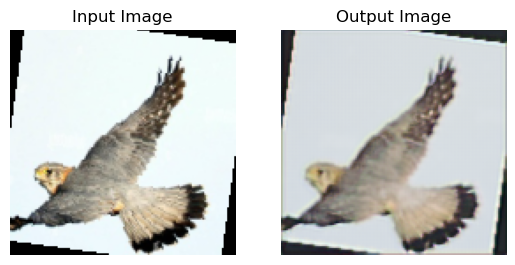

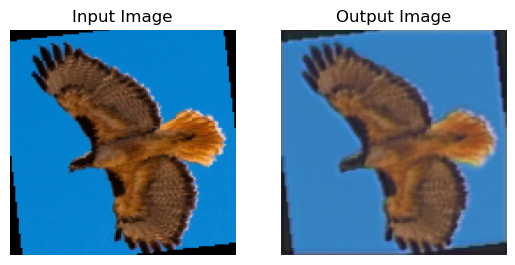

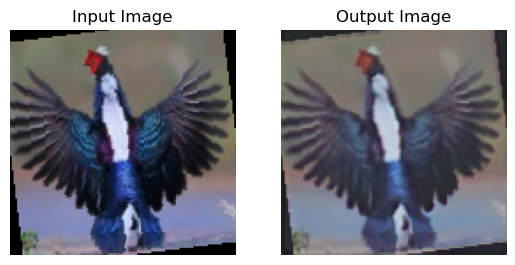

Epoch 3:   0%|          | 0/116 [00:00<?, ?it/s, v_num=3]          

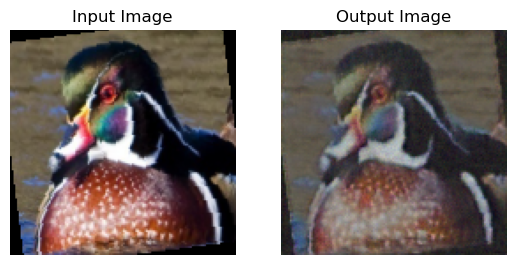

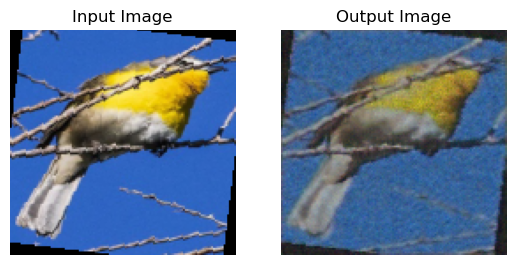

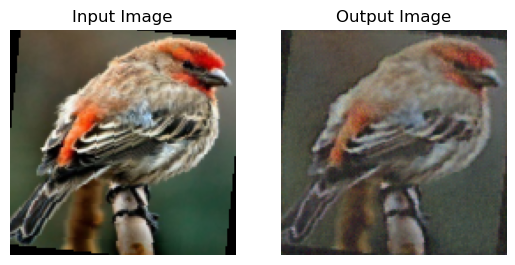

Epoch 3: 100%|██████████| 116/116 [00:18<00:00,  6.23it/s, v_num=3]

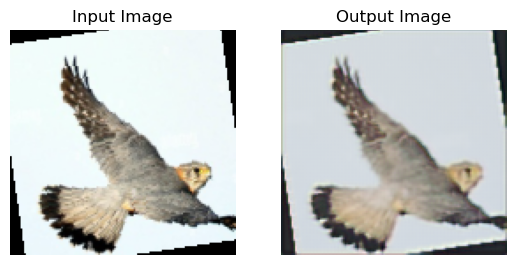

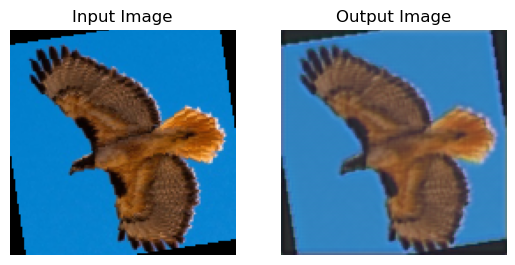

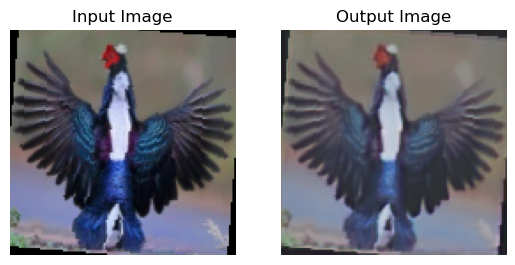

Epoch 4:   0%|          | 0/116 [00:00<?, ?it/s, v_num=3]          

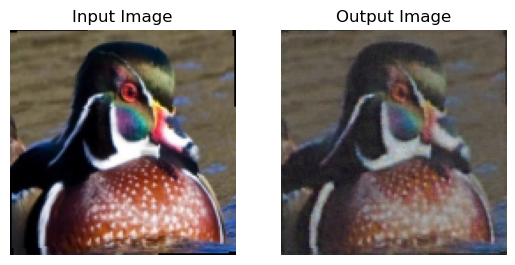

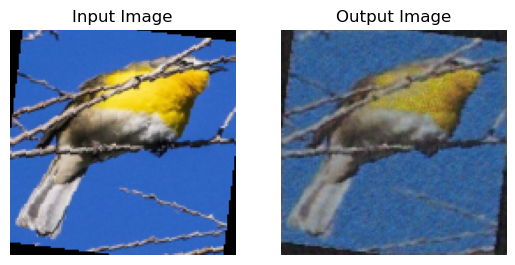

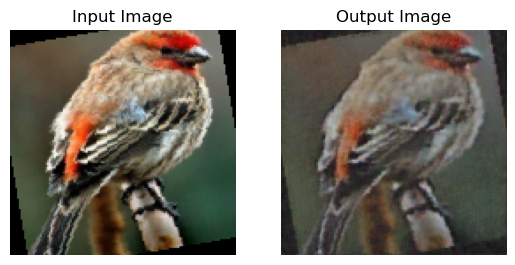

Epoch 4: 100%|██████████| 116/116 [00:18<00:00,  6.28it/s, v_num=3]

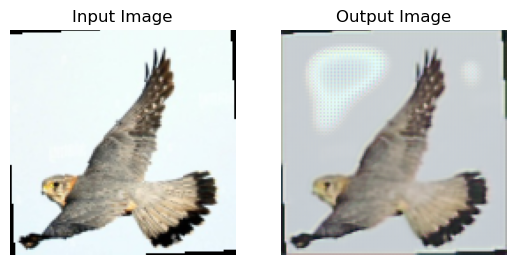

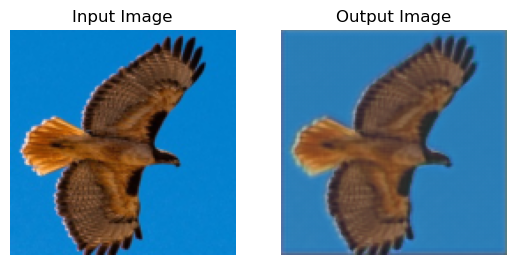

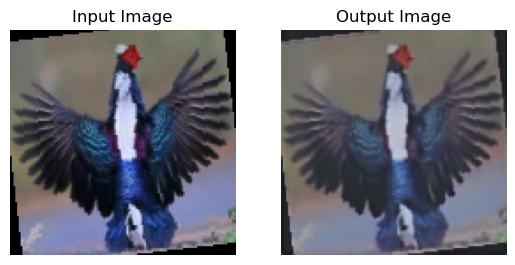

Epoch 5:   0%|          | 0/116 [00:00<?, ?it/s, v_num=3]          

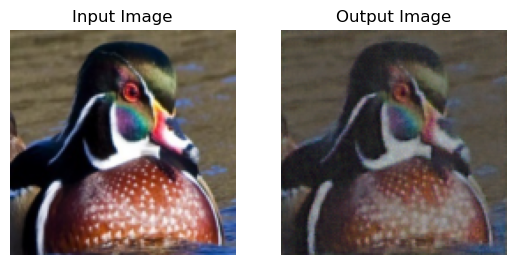

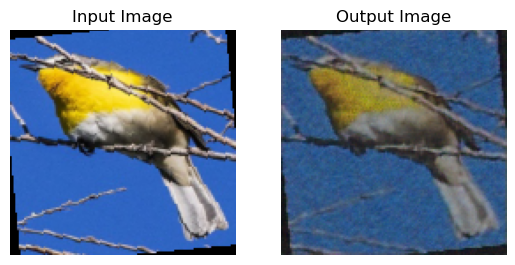

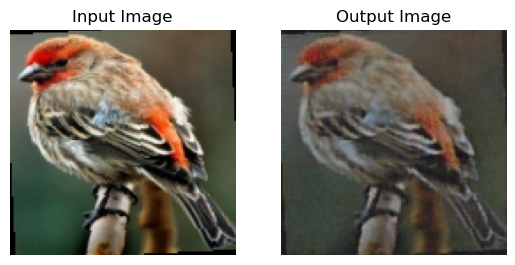

Epoch 5: 100%|██████████| 116/116 [00:18<00:00,  6.21it/s, v_num=3]

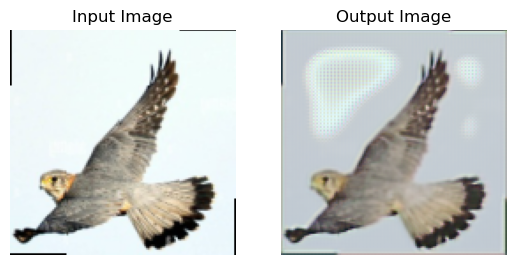

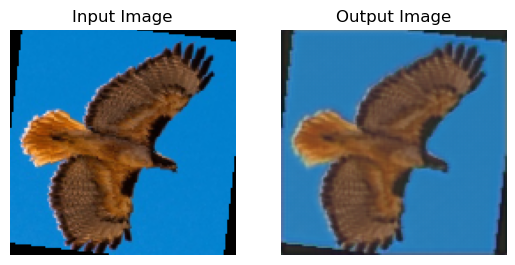

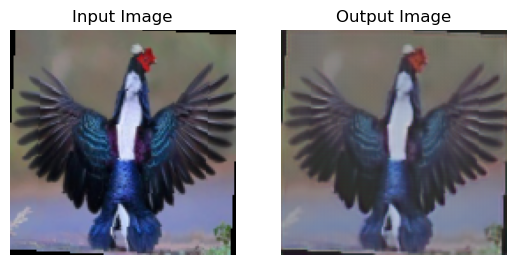

Epoch 6:   0%|          | 0/116 [00:00<?, ?it/s, v_num=3]          

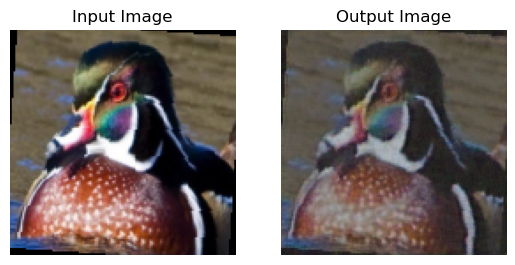

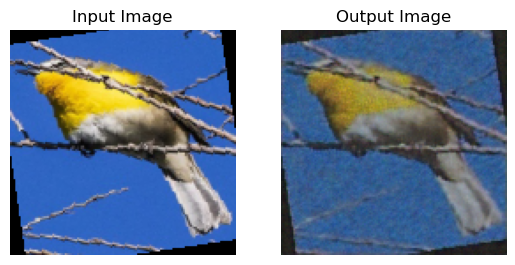

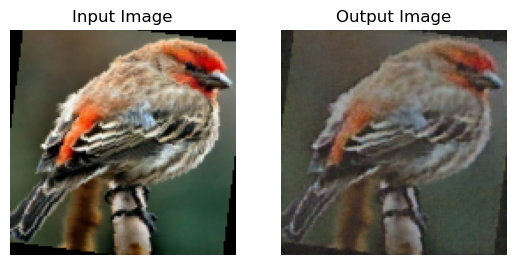

Epoch 6: 100%|██████████| 116/116 [00:18<00:00,  6.27it/s, v_num=3]

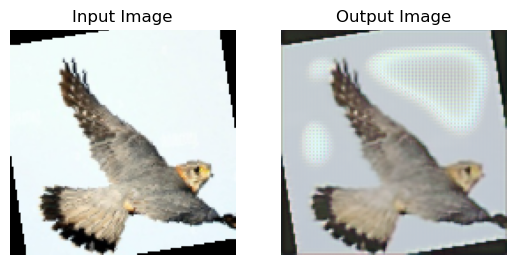

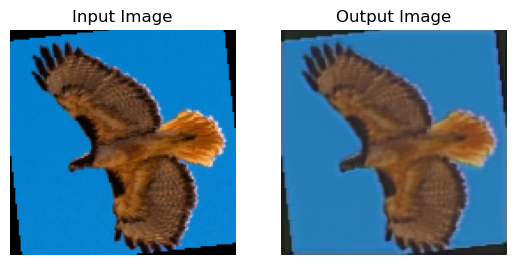

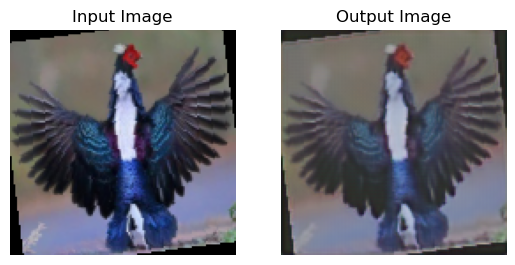

Epoch 7:   0%|          | 0/116 [00:00<?, ?it/s, v_num=3]          

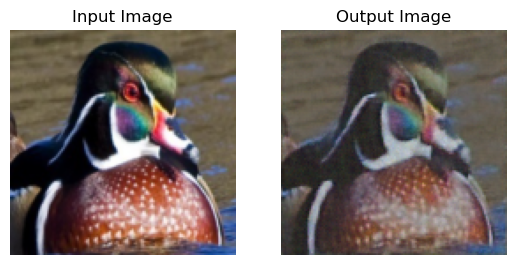

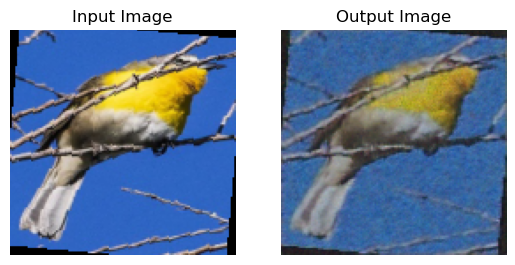

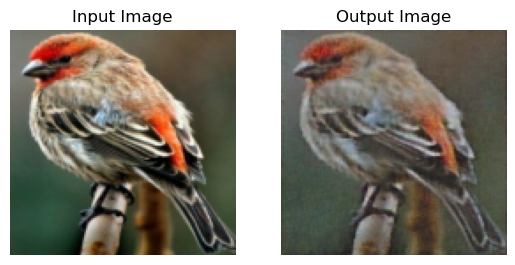

Epoch 7: 100%|██████████| 116/116 [00:18<00:00,  6.16it/s, v_num=3]

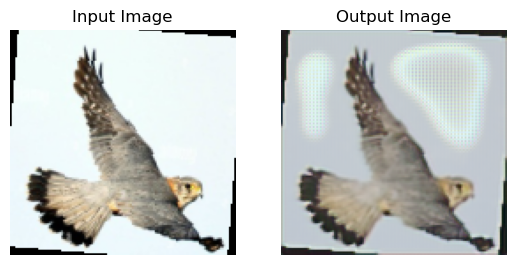

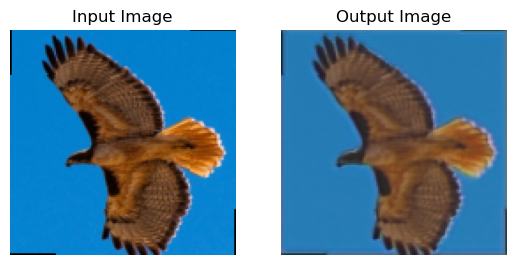

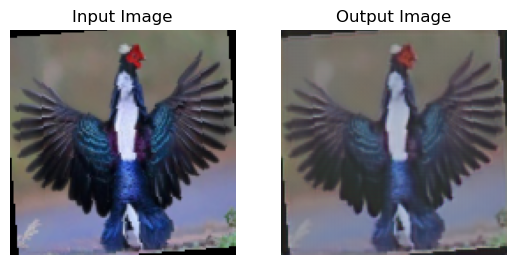

Epoch 8:   0%|          | 0/116 [00:00<?, ?it/s, v_num=3]          

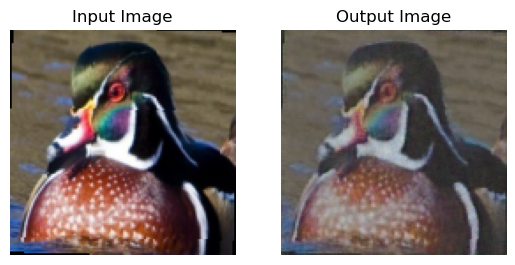

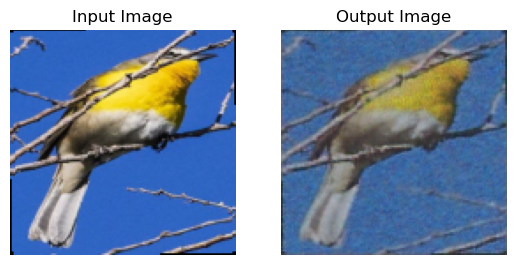

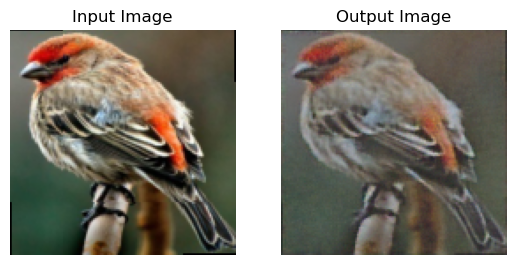

Epoch 8: 100%|██████████| 116/116 [00:18<00:00,  6.23it/s, v_num=3]

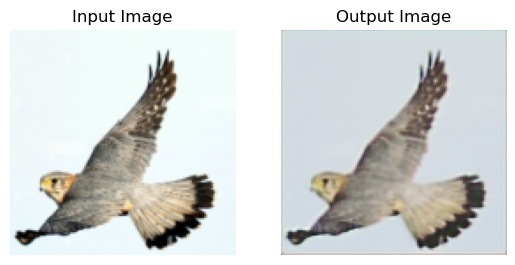

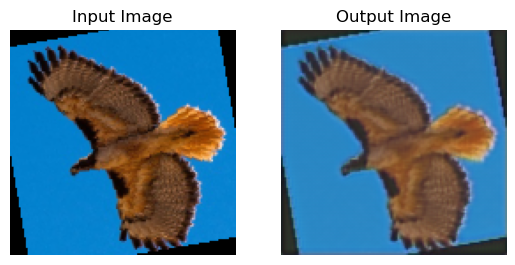

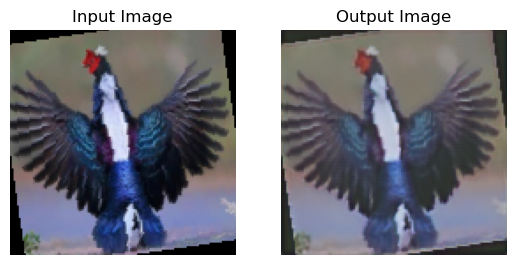

Epoch 9:   0%|          | 0/116 [00:00<?, ?it/s, v_num=3]          

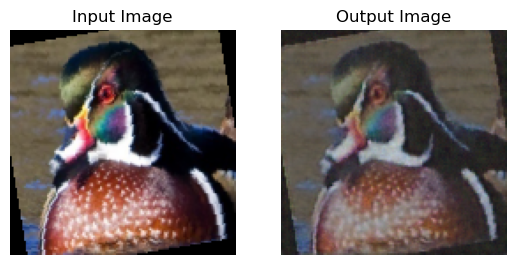

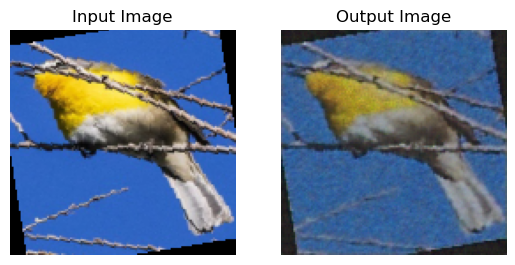

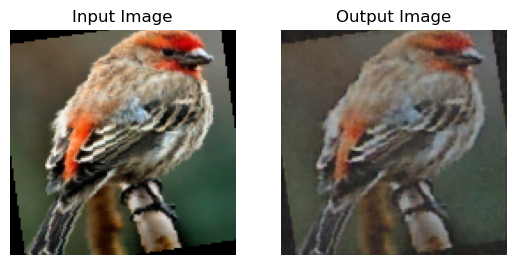

Epoch 9: 100%|██████████| 116/116 [00:18<00:00,  6.21it/s, v_num=3]

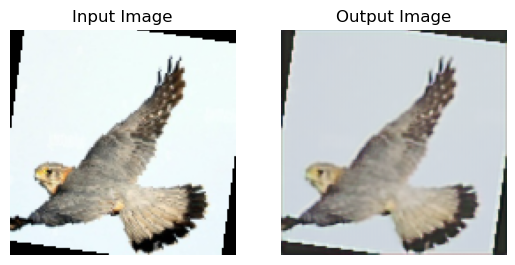

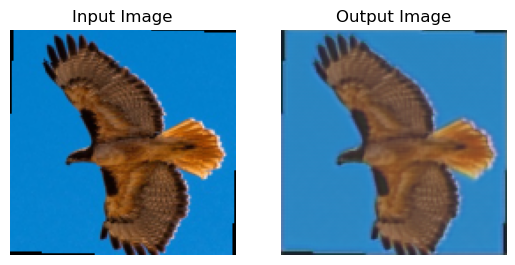

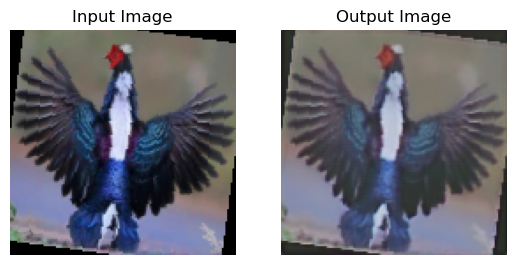

Epoch 9: 100%|██████████| 116/116 [00:20<00:00,  5.78it/s, v_num=3]

`Trainer.fit` stopped: `max_epochs=10` reached.


Epoch 9: 100%|██████████| 116/116 [00:20<00:00,  5.55it/s, v_num=3]


In [7]:
 
data_dir = r'C:\Users\tian_\Desktop\GitHub\Proyecto3IA\DataSplit\Data7030\70'
data_module = CustomDataModule(data_dir=data_dir, img_size=128)
model = UNetAutoencoder()

checkpoint_callback = ModelCheckpoint(
    dirpath=r'C:\Users\tian_\Desktop\lightning_logs',  # Directorio donde se guardará el modelo
    filename='unet_autoencoder',  # Nombre del archivo
    save_top_k=1,  # Guarda solo el mejor modelo
    monitor='val_loss',  # Monitorea la pérdida de validación para guardar el mejor modelo
    mode='min'  # Modo 'min' porque queremos minimizar la pérdida de validación
)

trainer = pl.Trainer(max_epochs=10, accelerator="gpu", default_root_dir=r'C:\Users\tian_\Desktop\lightning_logs')
trainer.fit(model, data_module)
torch.save(model.state_dict(), r'C:\Users\tian_\Desktop\lightning_logs\unet_autoencoderB1-70.pth')

In [2]:
# Definir callbacks

os.environ["WANDB_API_KEY"] = "ea93e82127178cd6709c03f277029a17909d3cbc"
wandb.login()
# Inicializar el logger de Weights & Biases


   

early_stopping_callback = EarlyStopping(
    monitor='valid_loss',
    patience=3,
    mode='min',
)
wandb_logger = WandbLogger(project="Proyecto3")
# Entrenador de PyTorch Lightning
trainer = pl.Trainer(
    max_epochs=30,
    accelerator="gpu",
    callbacks=[early_stopping_callback],
    logger=wandb_logger
)

# Definir el directorio de datos
data_dir = r'C:\Users\tian_\Desktop\GitHub\Proyecto3IA\DataSplit\Data7030\30'
num_classes = len(os.listdir(os.path.join(data_dir, 'train')))

classifier = AutoencoderVGG16(data_dir=data_dir, num_classes=num_classes)

checkpoint_callback = ModelCheckpoint(monitor="valid_acc")
early_stopping_callback = EarlyStopping(monitor='valid_loss', patience=5)

model = AutoencoderVGG16(data_dir=data_dir, num_classes=num_classes)
trainer.fit(model)

# Probar el modelo
trainer.test(model)

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: sebascam1498 (sebas1498). Use `wandb login --relogin` to force relogin
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name        | Type             | Params
-------------------------------------------------
0 | autoencoder | UNetAutoencoder  | 31.0 M
1 | model       | VGG              | 134 M 
2 | criterion   | CrossEntropyLoss | 0     
-------------------------------------------------
119 M     Trainable params
45.8 M    Non-trainable params
165 M     Total params
661.708   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `val_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:436: Consider setting `persistent_workers=True` in 'val_dataloader' to speed up the dataloader worker initialization.


c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:436: Consider setting `persistent_workers=True` in 'train_dataloader' to speed up the dataloader worker initialization.


Epoch 9: 100%|██████████| 55/55 [00:21<00:00,  2.58it/s, v_num=umk2, train_loss_step=1.890, train_acc_step=0.750, valid_loss_step=0.541, valid_acc_step=0.893, valid_loss_epoch=0.687, valid_acc_epoch=0.867, valid_loss=0.678, valid_acc=0.868, train_loss_epoch=0.980, train_acc_epoch=0.704]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:436: Consider setting `persistent_workers=True` in 'test_dataloader' to speed up the dataloader worker initialization.


Testing DataLoader 0: 100%|██████████| 8/8 [00:02<00:00,  3.87it/s]


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │         0.7890625         │
│      test_acc_epoch       │            0.8            │
│         test_loss         │    0.7458056211471558     │
│      test_loss_epoch      │     0.737928569316864     │
└───────────────────────────┴───────────────────────────┘

[{'test_loss_epoch': 0.737928569316864,
  'test_acc_epoch': 0.8,
  'test_loss': 0.7458056211471558,
  'test_acc': 0.7890625}]

# Clasificador B1 con autoencoder 90% y 10% con label

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\pytorch_lightning\trainer\connectors\logger_connector\logger_connector.py:75: Starting from v1.9.0, `tensorboardX` has been removed as a dependency of the `pytorch_lightning` package, due to potential conflicts with other packages in the ML ecosystem. For this reason, `logger=True` will use `CSVLogger` as the default logger, unless the `tensorboard` or `tensorboardX` packages are found. Please `pip install lightning[extra]` or one of them to enable TensorBoard support by default
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type        | Params
-------------------------------------------
0 | encoder1   | UNetEncoder | 39.0 K
1 | encoder2   | UNetEncoder | 221 K 
2 | encoder3   | UNetEncoder | 886 K 
3 | encoder4   | UNetEncoder | 3.5 M 
4 | bottlenec

Sanity Checking DataLoader 0:   0%|          | 0/2 [00:00<?, ?it/s]

c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=15` in the `DataLoader` to improve performance.


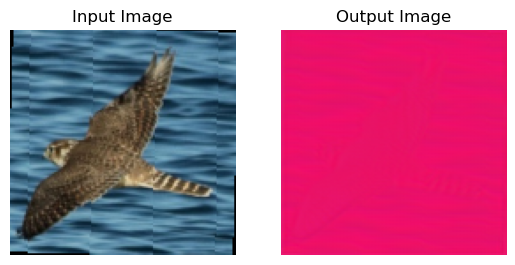

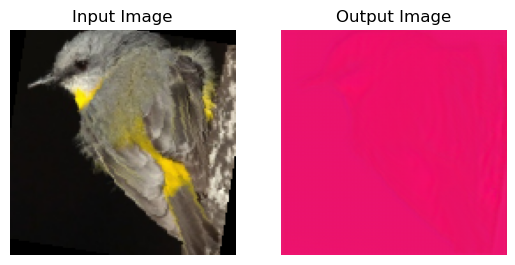

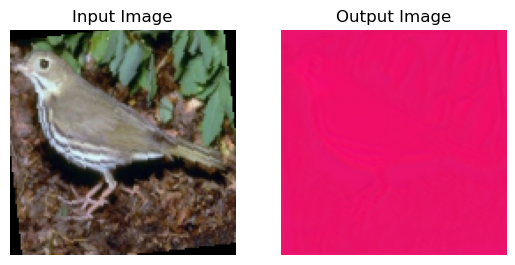

c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=15` in the `DataLoader` to improve performance.


Epoch 0:   0%|          | 0/149 [00:00<?, ?it/s] 

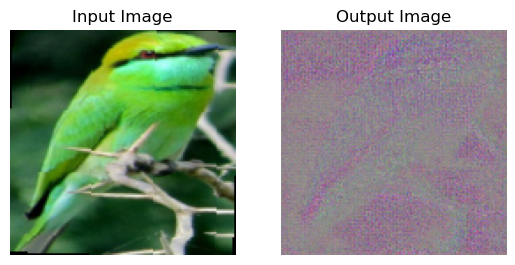

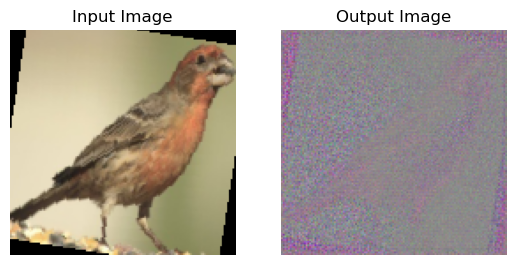

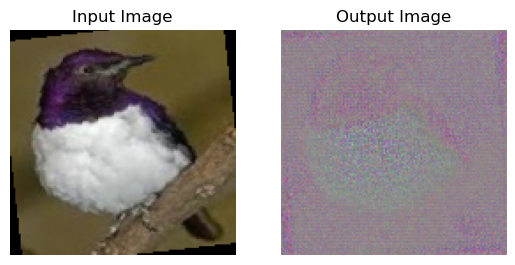

Epoch 0: 100%|██████████| 149/149 [00:24<00:00,  6.20it/s, v_num=5]

c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\torch\autograd\graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\cudnn\Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


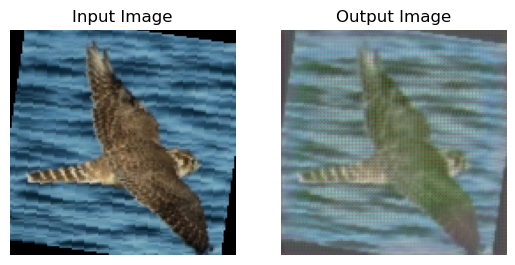

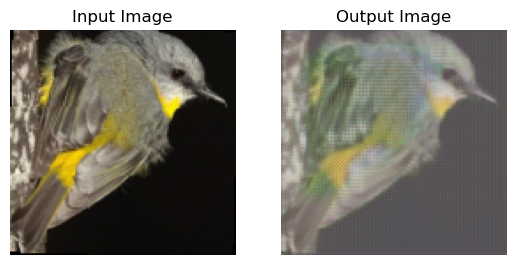

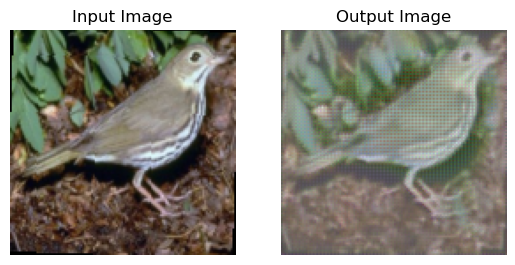

Epoch 1:   0%|          | 0/149 [00:00<?, ?it/s, v_num=5]          

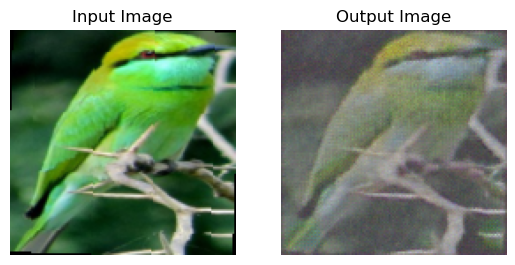

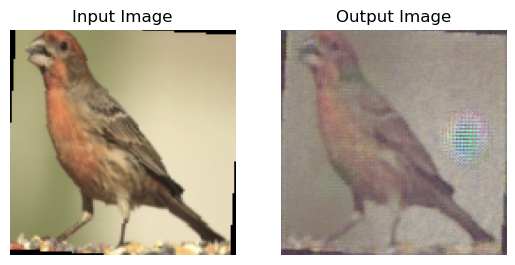

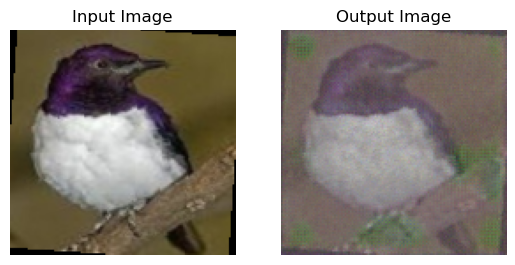

Epoch 1: 100%|██████████| 149/149 [00:23<00:00,  6.26it/s, v_num=5]

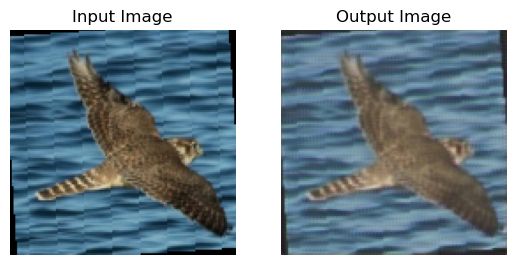

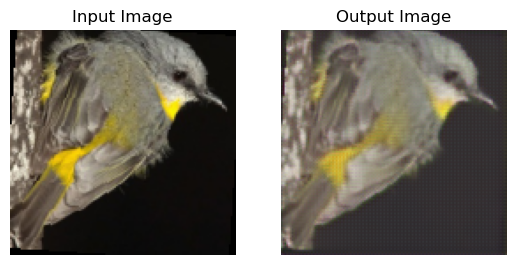

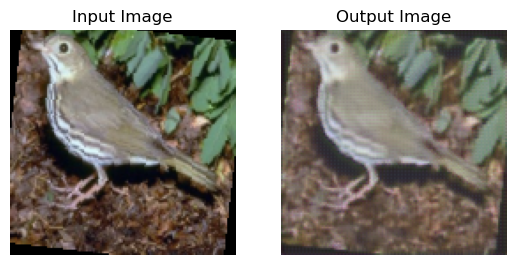

Epoch 2:   0%|          | 0/149 [00:00<?, ?it/s, v_num=5]          

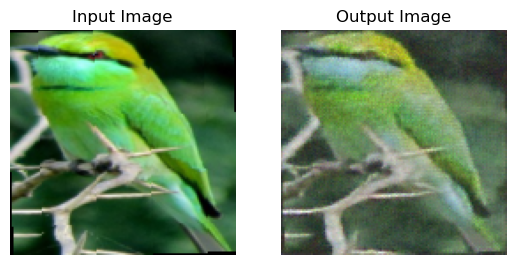

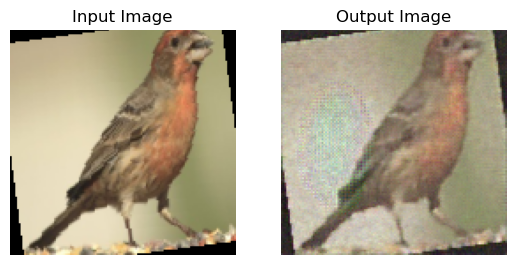

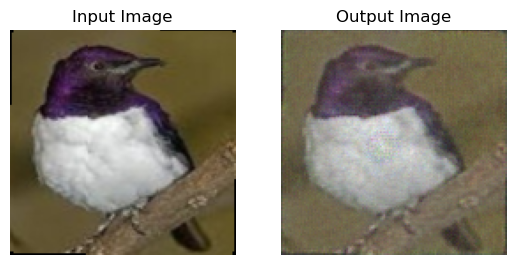

Epoch 2: 100%|██████████| 149/149 [00:23<00:00,  6.28it/s, v_num=5]

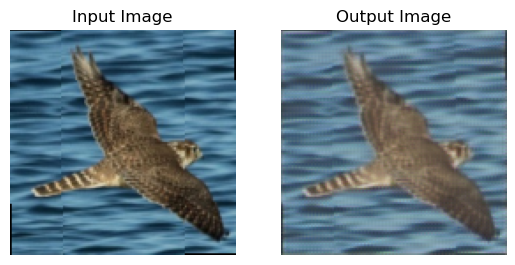

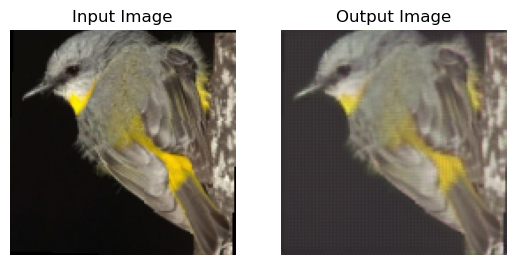

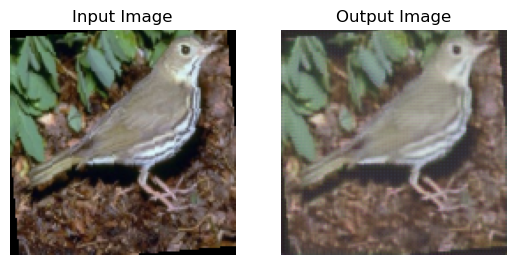

Epoch 3:   0%|          | 0/149 [00:00<?, ?it/s, v_num=5]          

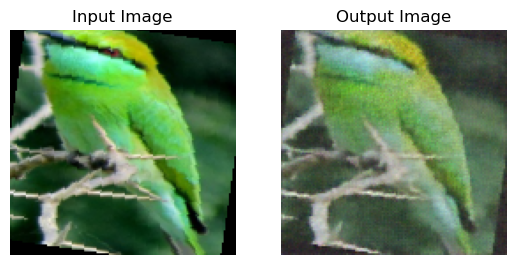

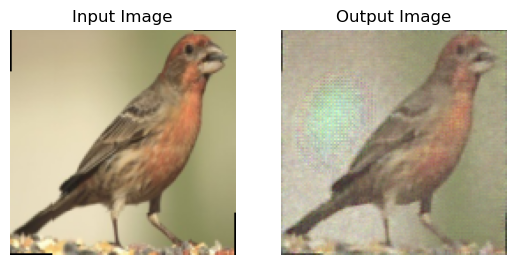

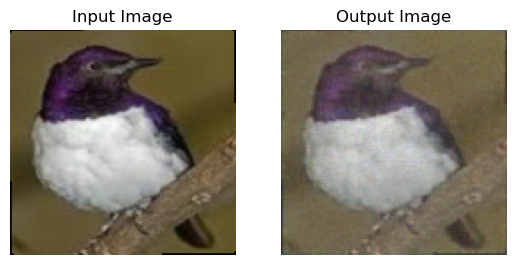

Epoch 3: 100%|██████████| 149/149 [00:23<00:00,  6.27it/s, v_num=5]

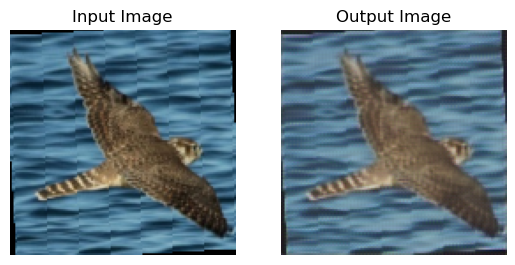

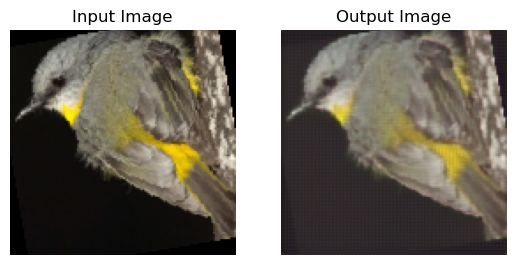

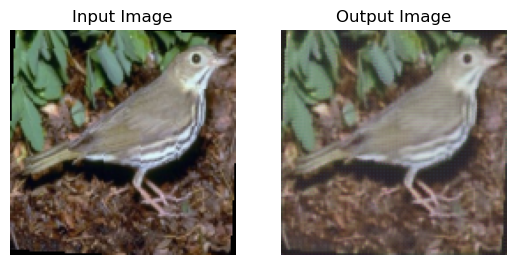

Epoch 4:   0%|          | 0/149 [00:00<?, ?it/s, v_num=5]          

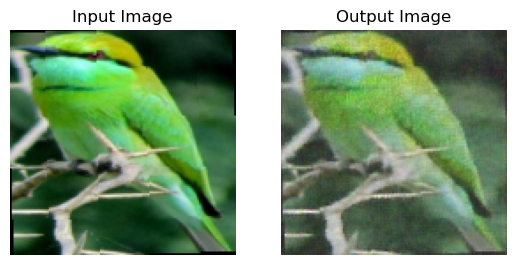

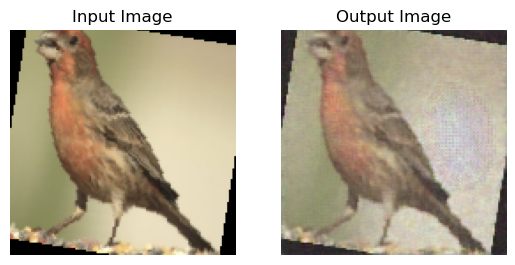

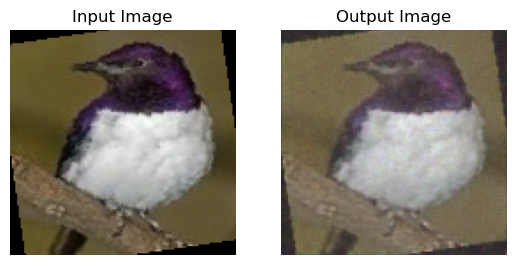

Epoch 4: 100%|██████████| 149/149 [00:23<00:00,  6.27it/s, v_num=5]

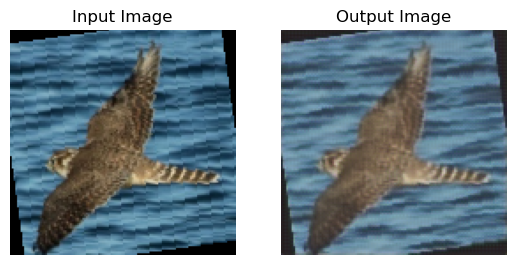

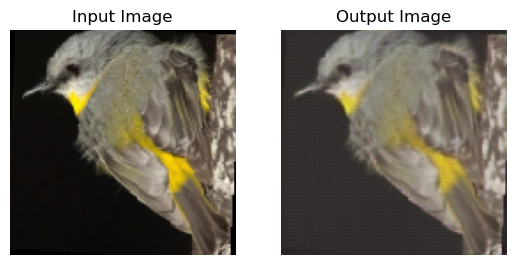

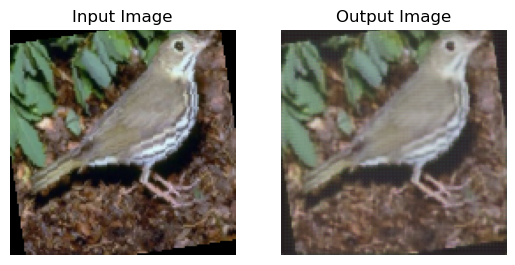

Epoch 5:   0%|          | 0/149 [00:00<?, ?it/s, v_num=5]          

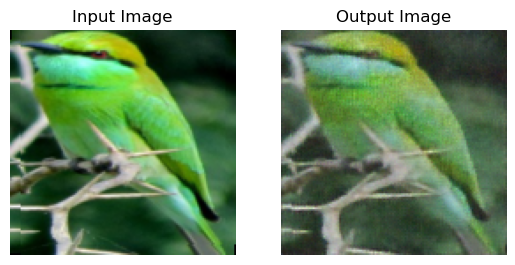

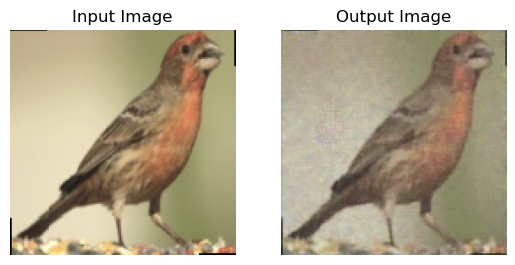

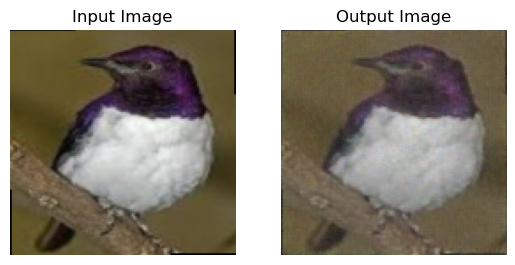

Epoch 5: 100%|██████████| 149/149 [00:23<00:00,  6.24it/s, v_num=5]

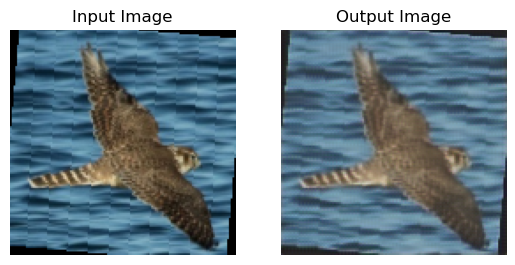

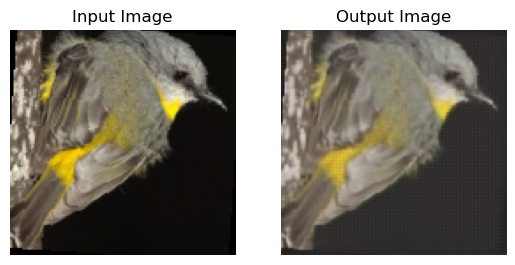

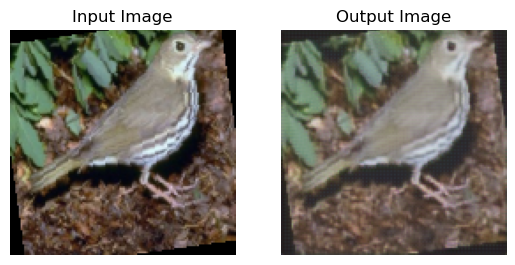

Epoch 6:   0%|          | 0/149 [00:00<?, ?it/s, v_num=5]          

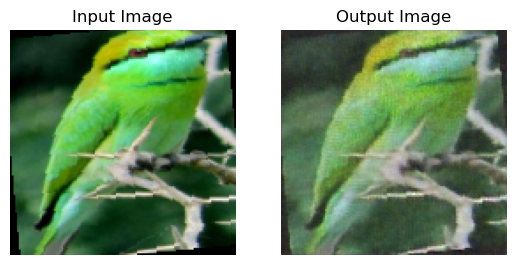

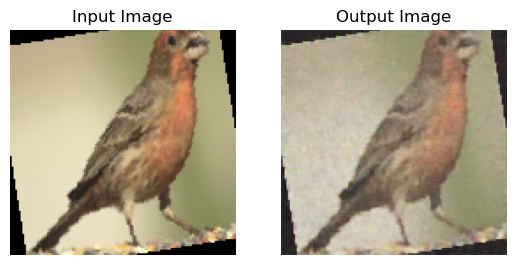

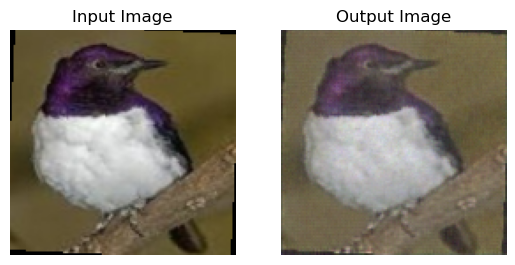

Epoch 6: 100%|██████████| 149/149 [00:23<00:00,  6.22it/s, v_num=5]

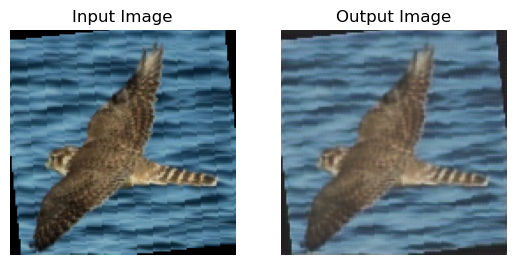

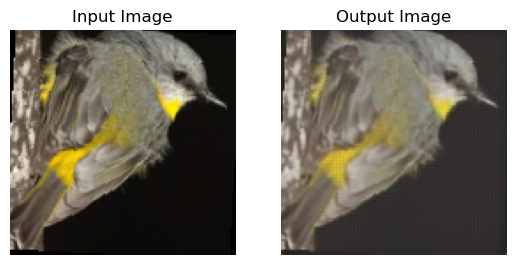

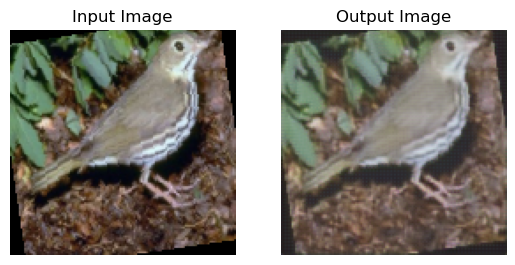

Epoch 7:   0%|          | 0/149 [00:00<?, ?it/s, v_num=5]          

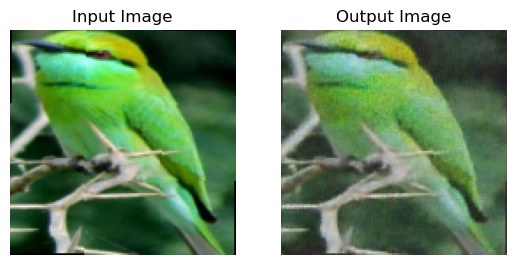

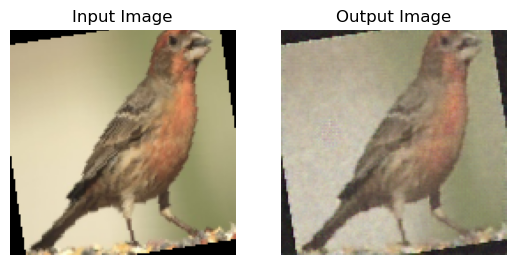

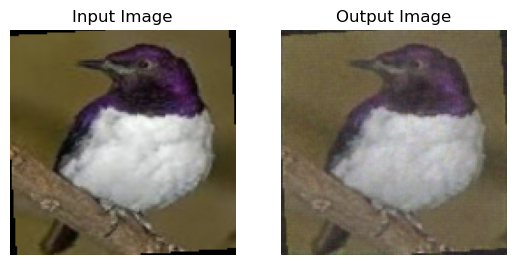

Epoch 7: 100%|██████████| 149/149 [00:24<00:00,  6.17it/s, v_num=5]

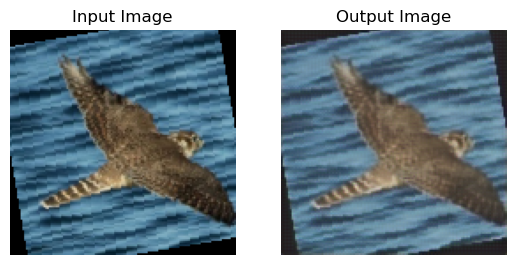

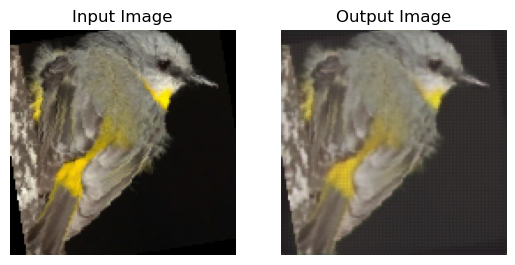

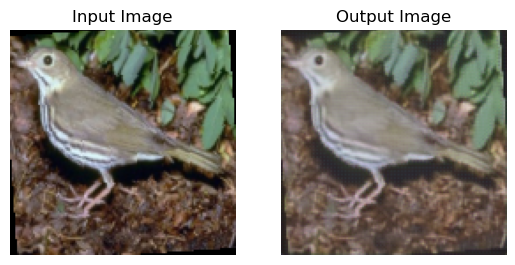

Epoch 8:   0%|          | 0/149 [00:00<?, ?it/s, v_num=5]          

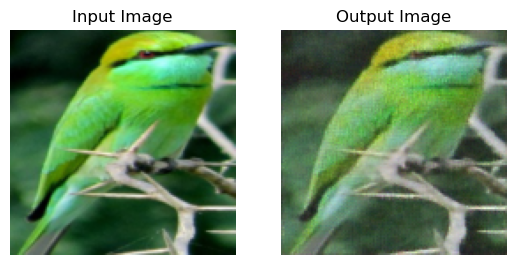

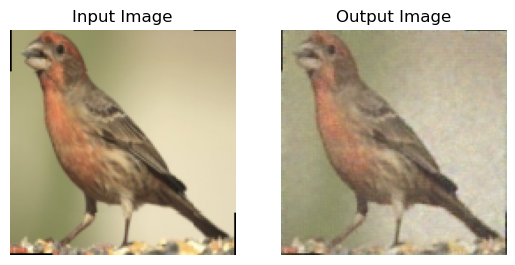

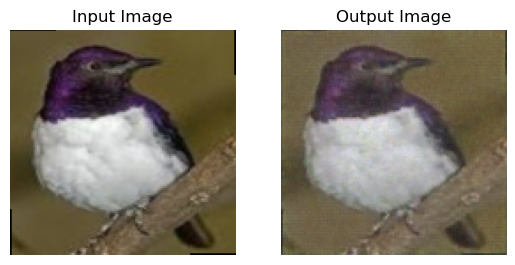

Epoch 8: 100%|██████████| 149/149 [00:24<00:00,  6.10it/s, v_num=5]

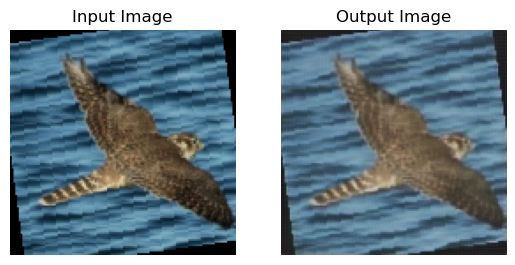

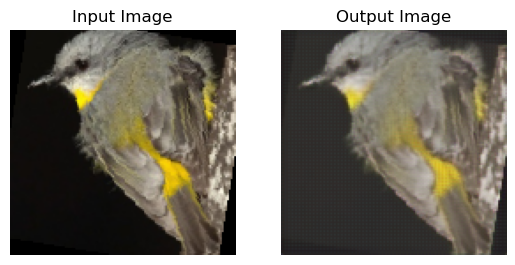

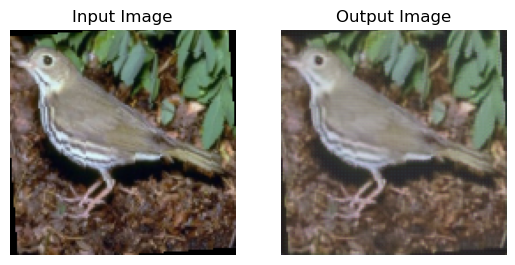

Epoch 9:   0%|          | 0/149 [00:00<?, ?it/s, v_num=5]          

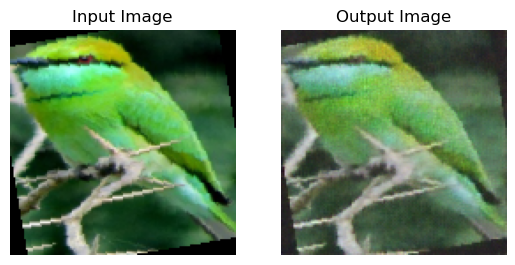

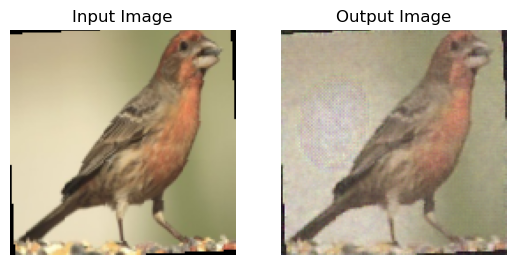

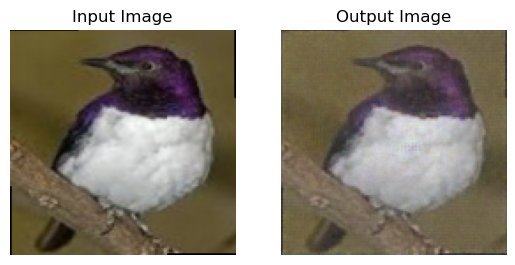

Epoch 9: 100%|██████████| 149/149 [00:24<00:00,  6.16it/s, v_num=5]

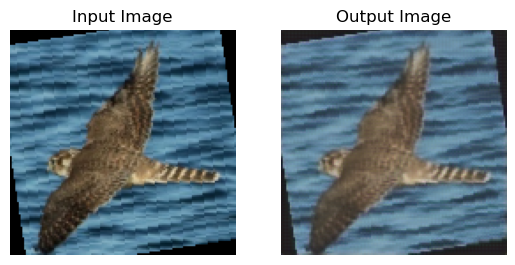

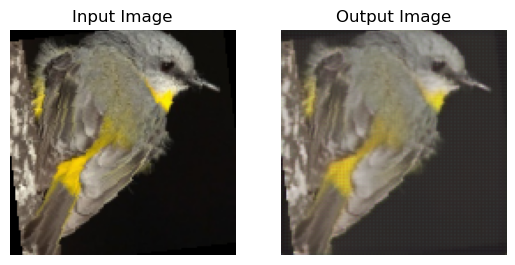

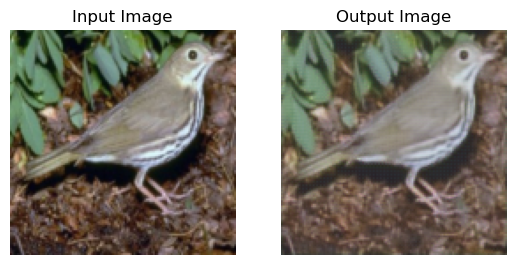

Epoch 9: 100%|██████████| 149/149 [00:25<00:00,  5.79it/s, v_num=5]

`Trainer.fit` stopped: `max_epochs=10` reached.


Epoch 9: 100%|██████████| 149/149 [00:26<00:00,  5.60it/s, v_num=5]


In [5]:
 
data_dir = r'C:\Users\tian_\Desktop\GitHub\Proyecto3IA\DataSplit\Data9010\90'
data_module = CustomDataModule(data_dir=data_dir, img_size=128)
model = UNetAutoencoder()

checkpoint_callback = ModelCheckpoint(
    dirpath=r'C:\Users\tian_\Desktop\lightning_logs',  # Directorio donde se guardará el modelo
    filename='unet_autoencoder',  # Nombre del archivo
    save_top_k=1,  # Guarda solo el mejor modelo
    monitor='val_loss',  # Monitorea la pérdida de validación para guardar el mejor modelo
    mode='min'  # Modo 'min' porque queremos minimizar la pérdida de validación
)

trainer = pl.Trainer(max_epochs=10, accelerator="gpu", default_root_dir=r'C:\Users\tian_\Desktop\lightning_logs')
trainer.fit(model, data_module)
torch.save(model.state_dict(), r'C:\Users\tian_\Desktop\lightning_logs\unet_autoencoderB1-90.pth')

In [2]:
# Definir callbacks

os.environ["WANDB_API_KEY"] = "ea93e82127178cd6709c03f277029a17909d3cbc"
wandb.login()
# Inicializar el logger de Weights & Biases


   
wandb_logger = WandbLogger(project="Proyecto3")
early_stopping_callback = EarlyStopping(
    monitor='valid_loss',
    patience=3,
    mode='min',
)

# Entrenador de PyTorch Lightning
trainer = pl.Trainer(
    max_epochs=30,
    accelerator="gpu",
    callbacks=[early_stopping_callback],
    logger=wandb_logger
)

# Definir el directorio de datos
data_dir = r'C:\Users\tian_\Desktop\GitHub\Proyecto3IA\DataSplit\Data9010\10'
num_classes = len(os.listdir(os.path.join(data_dir, 'train')))

classifier = AutoencoderVGG16(data_dir=data_dir, num_classes=num_classes)

checkpoint_callback = ModelCheckpoint(monitor="valid_acc")
early_stopping_callback = EarlyStopping(monitor="valid_acc", patience=5)

model = AutoencoderVGG16(data_dir=data_dir, num_classes=num_classes)
trainer.fit(model)

# Probar el modelo
trainer.test(model)

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: sebascam1498 (sebas1498). Use `wandb login --relogin` to force relogin
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name        | Type             | Params
-------------------------------------------------
0 | autoencoder | UNetAutoencoder  | 31.0 M
1 | model       | VGG              | 134 M 
2 | criterion   | CrossEntropyLoss | 0     
-------------------------------------------------
119 M     Trainable params
45.8 M    Non-trainable params
165 M     Total params
661.708   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `val_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:436: Consider setting `persistent_workers=True` in 'val_dataloader' to speed up the dataloader worker initialization.


c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:436: Consider setting `persistent_workers=True` in 'train_dataloader' to speed up the dataloader worker initialization.
c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\pytorch_lightning\loops\fit_loop.py:298: The number of training batches (19) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Epoch 10: 100%|██████████| 19/19 [00:10<00:00,  1.82it/s, v_num=ir01, train_loss_step=0.868, train_acc_step=0.818, valid_loss_step=0.745, valid_acc_step=0.733, valid_loss_epoch=0.745, valid_acc_epoch=0.733, valid_loss=0.745, valid_acc=0.733, train_loss_epoch=0.995, train_acc_epoch=0.697] 


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\tian_\AppData\Local\anaconda3\envs\Pytorch_env\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:436: Consider setting `persistent_workers=True` in 'test_dataloader' to speed up the dataloader worker initialization.


Testing DataLoader 0: 100%|██████████| 3/3 [00:01<00:00,  1.75it/s]


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │    0.7123397435897436     │
│      test_acc_epoch       │    0.7111111111111111     │
│         test_loss         │    1.0178256034851074     │
│      test_loss_epoch      │    1.0181868076324463     │
└───────────────────────────┴───────────────────────────┘

[{'test_loss_epoch': 1.0181868076324463,
  'test_acc_epoch': 0.7111111111111111,
  'test_loss': 1.0178256034851074,
  'test_acc': 0.7123397435897436}]